# Поиск fraud - отзывов

**Постановка задачи**:
Пользователи загружают изображения в раздел отзывы. Недобросовестные пользователи используют отзывы для рекламы своих товаров или услуг.

Так могут выглядеть допустимые изображений:


<img src ="https://ml.gan4x4.ru/wb/text/content/not_fraud.png" width="800">

Вот примеры недопустимых изображений:

<img src ="https://ml.gan4x4.ru/wb/text/content/fraud.png" width="800">

Как правило такие изображения содержат контактные данные: номера телефонов, ссылку на сайт, телеграмм аккаунт и.т.п.




**Требуется** :

Разработать алгоритм/програмную систему позволяющую отличить допустимые фото от недопустимых. Сложность  обуславливается тем, что допустимые фотографии тоже могут содержать текст.


**Ограничения**:
Допускается использовать любые модели/алгоритмы/данные находящиеся в свободном доступе.


**Важно!**

Блокнот должен содержать весь необходимый код для запуска финальной модели.
В том числе код для установки сторонних библиотек. Если для запуска требуется подгрузка весов, все ссылки длжны работать не только в вашем аккаунте но и в аккаунте преподавателя. Проверьте что блок для проверки запускается в colab.

## Данные

Датасет состоит из ~20000 изображений. Изображения находящиеся в папке “0” - допустимые. В папке “1” - фродовые. Ниже код для его загрузки.



In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!mkdir data
TASK_PATH = '/content'

In [4]:
!wget -P $TASK_PATH https://ml.gan4x4.ru/wb/text/75_20000/student.zip
!unzip "{TASK_PATH}/student.zip" -d "{TASK_PATH}/data"

Streaming output truncated to the last 5000 lines.
  inflating: /content/data/student/0/165549915.jpg  
  inflating: /content/data/student/0/168140935.jpg  
  inflating: /content/data/student/0/138750805.jpg  
  inflating: /content/data/student/0/167949858.jpg  
  inflating: /content/data/student/0/138640702.jpg  
  inflating: /content/data/student/0/134580396.jpg  
  inflating: /content/data/student/0/166891740.jpg  
  inflating: /content/data/student/0/144942407.jpg  
  inflating: /content/data/student/0/167163464.jpg  
  inflating: /content/data/student/0/165713620.jpg  
  inflating: /content/data/student/0/124272811.jpg  
  inflating: /content/data/student/0/127734193.jpg  
  inflating: /content/data/student/0/165069600.jpg  
  inflating: /content/data/student/0/168155894.jpg  
  inflating: /content/data/student/0/134343645.jpg  
  inflating: /content/data/student/0/166176778.jpg  
  inflating: /content/data/student/0/165321187.jpg  
  inflating: /content/data/student/0/168748850.j

## Imports

In [5]:
!pip install -q split-folders pytorch_lightning==2.0.0 efficientnet_pytorch

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 715.6/715.6 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 866.2/866.2 kB 13.9 MB/s eta 0:00:00


In [74]:
# библиотеки для работы с изображениями
import os
import cv2
from PIL import Image
import numpy as np
# библиотека для работы с путями
from pathlib import Path
# вспомогательные
import matplotlib.pyplot as plt

# для работы
import torch
import torch.nn as nn
import torch.nn.functional as F
import splitfolders
from torchvision import transforms, utils
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torch.utils.data.sampler import WeightedRandomSampler
import pytorch_lightning as pl
from torchmetrics import Accuracy, F1Score
from efficientnet_pytorch import EfficientNet


# автоматическое логивароение результатов
from pytorch_lightning.loggers import TensorBoardLogger
# сохранение весов
from pytorch_lightning.callbacks.model_checkpoint import ModelCheckpoint
# автоматическое отслеживание lr
from pytorch_lightning.callbacks import LearningRateMonitor
# ранние остановки
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

# дополнительные импорты
import gc
from collections import Counter
from tqdm.autonotebook import tqdm
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
import warnings


SEED = 21
pl.seed_everything(SEED)
torch.backends.cudnn.deterministic = True
plt.style.use('dark_background')
warnings.filterwarnings("ignore")

INFO:lightning_fabric.utilities.seed:Global seed set to 21


## Смотрим данные

#### Размеры классов

Количество изоражений с фродом:

In [7]:
!ls '{TASK_PATH}/data/student/1'  | wc -l

4808


Количество чистых изображений

In [8]:
!ls '{TASK_PATH}/data/student/0'  | wc -l

15000


In [9]:
print(f'{4808/(4808+15000):.2f}, {15000/(4808+15000):.2f}')

0.24, 0.76


##### Вывод: явный дисбаланс классов 24% / 76%

#### Корректность разметки

In [10]:
DATASET_1 = Path(f"{TASK_PATH}/data/student/1")
DATASET_0 = Path(f"{TASK_PATH}/data/student/0")


In [11]:
# пробегаем по директории с картинками и добавляем в список
images_1 = [p.resolve() for p in DATASET_1.glob("**/*") if p.suffix in {".png", ".jpg", ".jpeg"}]
images_0 = [p.resolve() for p in DATASET_0.glob("**/*") if p.suffix in {".png", ".jpg", ".jpeg"}]


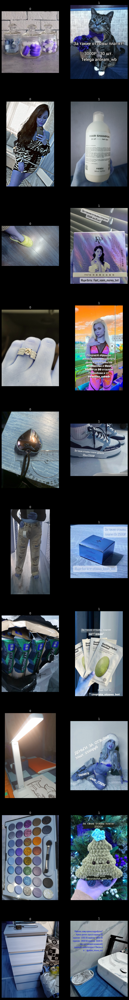

In [12]:
n_samples = 10 # сколько вывести для просмотра

def get_img_id(name_defect):
    if name_defect == '1':
        img_ids = [x.stem for x in map(images_1.__getitem__, np.random.randint(len(images_1), size=n_samples))]
    else:
        img_ids = [x.stem for x in map(images_0.__getitem__, np.random.randint(len(images_0), size=n_samples))]
    return img_ids

def show():
    columns_name = ['0', '1']
    fig, axes = plt.subplots(nrows=n_samples, ncols=2, figsize=(n_samples, 8*n_samples))
    for name_id in range(len(columns_name)):
      img_ids = get_img_id(columns_name[name_id])
      for img_id in range(len(img_ids)):
        img = cv2.imread(f"{TASK_PATH}/data/student/" + columns_name[name_id] +'/'+ str(img_ids[img_id]) + '.jpg')
        axes[img_id][name_id].imshow(img)
        axes[img_id][name_id].axis('off')
        axes[img_id][name_id].set_title(columns_name[name_id])


show()

##### Вывод: есть неточно размеченные изображения

#### Размеры изображений

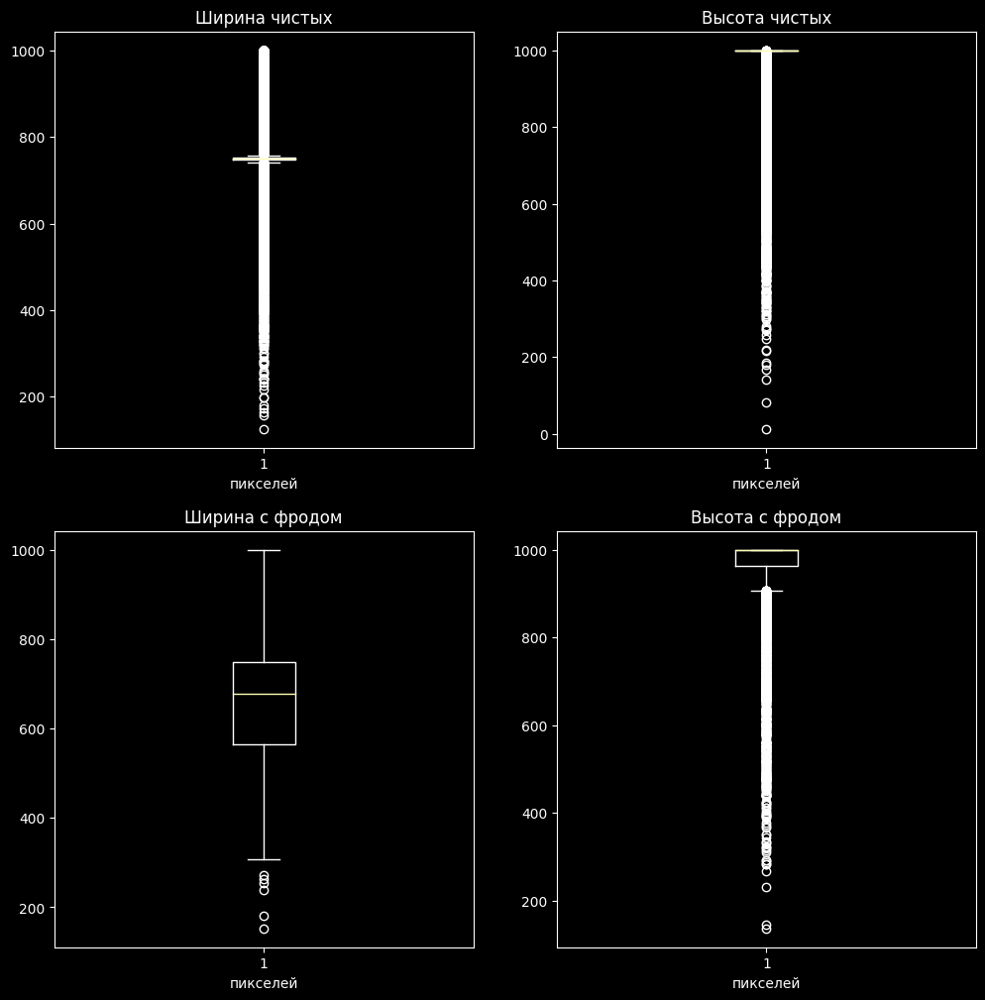

In [72]:
image_dir_0 = '/content/data/student/0'
image_dir_1 = '/content/data/student/1'

widths_0 = []
heights_0 = []
widths_1 = []
heights_1 = []

for filename in os.listdir(image_dir_0):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_dir_0, filename)
        image = Image.open(image_path)
        width, height = image.size

        widths_0.append(width)
        heights_0.append(height)

for filename in os.listdir(image_dir_1):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(image_dir_1, filename)
        image = Image.open(image_path)
        width, height = image.size

        widths_1.append(width)
        heights_1.append(height)

fig, ax = plt.subplots(2, 2, figsize=(12, 12))

ax[0][0].boxplot(widths_0)
ax[0][0].set_title('Ширина чистых')
ax[0][0].set_xlabel('пикселей')

ax[0][1].boxplot(heights_0)
ax[0][1].set_title('Высота чистых')
ax[0][1].set_xlabel('пикселей')

ax[1][0].boxplot(widths_1)
ax[1][0].set_title('Ширина с фродом')
ax[1][0].set_xlabel('пикселей')

ax[1][1].boxplot(heights_1)
ax[1][1].set_title('Высота с фродом')
ax[1][1].set_xlabel('пикселей')

plt.show()

##### Вывод: Большой разброс в размерах изображений, есть совсем маленькие

## Разбиваем данные

In [13]:
splitfolders.ratio(
                    f"{TASK_PATH}/data/student",
                    output=f"{TASK_PATH}/data/fraud_split",
                    seed=21,
                    ratio=(.8, .1, .1),
                    group_prefix=None,
                    move=False
)

Copying files: 19808 files [01:10, 279.21 files/s]


## Datamodule для загрузки данных

In [14]:
class ImgDataModule(pl.LightningDataModule):
  def __init__(self,
               batch_size = 1,
               train_transform=None,
               val_transform=None,
               img_root = f"{TASK_PATH}/data/fraud_split",
               sampler=None
               ):
    super().__init__()
    self.batch_size = batch_size
    self.train_transform = train_transform
    self.val_transform = val_transform
    self.img_root = img_root
    self.sampler = sampler

  def setup(self, stage=None):
    # метод содержит информацию о датасете
    self.train_set = ImageFolder(self.img_root / Path("train"), transform=self.train_transform)
    self.val_set = ImageFolder(self.img_root / Path("val"), transform=self.val_transform)
    self.test_set = ImageFolder(self.img_root / Path("test"), transform=self.val_transform)

  def train_dataloader(self):
    # метод создает загрузчик
    return DataLoader(self.train_set, sampler=self.sampler, batch_size=self.batch_size, shuffle=True, num_workers=2)

  def val_dataloader(self):
    return DataLoader(self.val_set, batch_size=self.batch_size, shuffle=False, num_workers=2)

  def test_dataloader(self):
    return DataLoader(self.test_set, batch_size=self.batch_size, shuffle=False, num_workers=2)

In [15]:
images = [p.resolve() for p in Path(f"{TASK_PATH}/data/fraud_split/train").glob("**/*") if p.suffix in {".png", ".jpg", ".jpeg"}]
len(images)

15846

### WeightedRandomSampler - для обработки дисбаланса

In [16]:
c = Counter(i.parts[-2] for i in images)
print(c)

weights = [1/c.get(i.parts[-2]) for i in images]
sampler = WeightedRandomSampler(weights, num_samples=len(weights))
print(len(weights), sum(weights))

Counter({'0': 12000, '1': 3846})
15846 1.9999999999998843


In [17]:
dm = ImgDataModule(sampler=sampler)
dm.setup()
{k:v for k, v in enumerate(dm.test_set.classes)}

{0: '0', 1: '1'}

 ## Метрика качества

### F1 - пристутствует дисбаланс, по заданию не ясно какого рода ошибка для нас менее желанна, поэтому такой выбор
$$ F_1 = \frac{2*P*R}{P+R} $$

также посмотрим на Precision и Recall

# Решение 1 : **efficientnet-b0**

## Создание модели efficientnet-b0

In [ ]:
class EffNetClassifier(pl.LightningModule):
  # обязательный метод
  def __init__(self,
               model = "efficientnet-b0",
               in_channels = 3,
               out_classes = 2,
               eta = 3e-4,
               **kwargs):
    super().__init__()
    self.save_hyperparameters()
    self.model = EfficientNet.from_pretrained(model,
                                              num_classes = out_classes,
                                              in_channels = in_channels)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    self.out_classes = out_classes
    class_weights = torch.tensor([0.24, 0.76]).to(device)
    self.criterion = nn.CrossEntropyLoss(weight=class_weights)
    self.metrics = {"accuracy": Accuracy(task="binary", num_classes=out_classes).to(device),
                    "f1_score": F1Score(task="binary", num_classes=out_classes).to(device),
                    "confusion_matrix": confusion_matrix}
    # хотим собирать метрики
    self.preds_stage = {"train":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "valid":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "test":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))}}

  # обязательный метод
  def forward(self, x):
    return self.model(x)
  # метод общий для всех
  def shared_step(self,
                  sample,
                  stage):
    x, y = sample
    logits = self.forward(x.to(torch.float32))
    preds = torch.argmax(logits, 1)
    loss = self.criterion(logits, y.to(torch.int64))
    # собираем в атрибут
    self.preds_stage[stage]['loss'].append(loss.detach().cpu())
    self.preds_stage[stage]['accuracy'].append(self.metrics["accuracy"](preds, y).detach().cpu())
    self.preds_stage[stage]['confusion_array'] += (self.metrics["confusion_matrix"](y.cpu().numpy(), preds.cpu().numpy()))
    return loss

  # метод общий для всех
  def shared_epoch_end(self,
                       stage):
    # считаем по стадиям
    loss = self.preds_stage[stage]['loss']
    loss = torch.stack(loss)
    loss = np.mean([x.item() for x in loss])

    acc = self.preds_stage[stage]['accuracy']
    acc = torch.stack(acc)
    acc = np.mean([x.item() for x in acc])

    TN, FP, FN, TP = self.preds_stage[stage]['confusion_array'].ravel()
    precision = TP / (TP + FP) if (TP + FP) > 0 else 0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall)
    print(f'Epoch {stage} : f1={f1}')

    metrics = {
        f"{stage}_loss": loss,
        f"{stage}_acc": acc,
        f"{stage}_f1": f1
    }

    self.log_dict(metrics, prog_bar=True)
    # чистим
    self.preds_stage[stage]['loss'].clear()
    self.preds_stage[stage]['accuracy'].clear()
    self.preds_stage[stage]['confusion_array'] = np.zeros((2,2))


  # обязательный шаг - создаем оптимизатор, BONUS - шедулер
  def configure_optimizers(self):
    # sgd чтобы не срезать сразу веса а постепенно шагать
    optimizer = torch.optim.SGD(
        self.parameters(),
        lr = self.hparams.eta
    )

    scheduler_dict = {
        "scheduler": torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
            patience=5
        ),
        "interval": "epoch",
        "monitor": "valid_loss"
    }
    return {"optimizer": optimizer, "lr_scheduler": scheduler_dict}
  # шаг обучения
  def training_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "train")
  # шаг подсчета метрик обучения
  def on_training_epoch_end(self):
      return self.shared_epoch_end("train")
  # шаг валидации
  def validation_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "valid")
  # шаг подсчета метрик валидации
  def on_validation_epoch_end(self):
    return self.shared_epoch_end("valid")
  # шаг тестирования
  def test_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "test")
  # шаг подсчета метрик тестирования
  def on_test_epoch_end(self):
    return self.shared_epoch_end("test")

## Настройка обучения

In [ ]:
# трансформации для обучения
transform_train = transforms.Compose([
                    transforms.Resize((224, 224)),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                        std=[0.229, 0.224, 0.225])
                  ])

# трансформации для валидации и теста
transform_test = transforms.Compose([
                    transforms.Resize((224, 224)),
                    transforms.ToTensor(),
                    transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                        std=[0.229, 0.224, 0.225])
                 ])

In [ ]:
BATCH = 100
# создаем DataModule-экземпляр
dm = ImgDataModule(BATCH, transform_train, transform_test)
EXPERIMENT = "efficientnet-b0"
ETA = 3*10e-3
model = EffNetClassifier(eta=ETA, model=EXPERIMENT)
# список для отслеживания lr, ранних остановок, сохранения весов
callbacks = [
            ModelCheckpoint(
                dirpath=f'{TASK_PATH}/data/models/{EXPERIMENT}',
                filename='{epoch}_{valid_f1:.3f}_{valid_loss:.3f}',
                save_top_k=2,
                monitor='valid_loss',
                mode='min'
            ),
             LearningRateMonitor(logging_interval="step"),
             EarlyStopping(monitor="valid_loss",
                           min_delta=2e-5,
                           patience=10,
                           verbose=False,
                           mode="min")
]
# указываем путь для логирования и логер
TENSOR = f"{TASK_PATH}/data/logs/{EXPERIMENT}"
logger = TensorBoardLogger(TENSOR, name=EXPERIMENT)
# стартуем с нуля, поэтому передаем тут checkpoint None
CHECKPOINT = None
# создаем трейнер - класс, который будет обучать
trainer = pl.Trainer(
        max_epochs=100,
        logger=logger,
        callbacks=callbacks
)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


Loaded pretrained weights for efficientnet-b0


In [ ]:
%load_ext tensorboard
%tensorboard --logdir "{TASK_PATH}/data/logs/{EXPERIMENT}"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Fit

In [ ]:
trainer.fit(model, dm)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | EfficientNet     | 4.0 M 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
4.0 M     Trainable params
0         Non-trainable params
4.0 M     Total params
16.040    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

nan


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

0.8316467341306348


Validation: 0it [00:00, ?it/s]

0.8807881773399014


Validation: 0it [00:00, ?it/s]

0.900702106318957


Validation: 0it [00:00, ?it/s]

0.9103585657370519


Validation: 0it [00:00, ?it/s]

0.9121756487025948


Validation: 0it [00:00, ?it/s]

0.9205702647657842


Validation: 0it [00:00, ?it/s]

0.9206030150753769


Validation: 0it [00:00, ?it/s]

0.9173387096774194


Validation: 0it [00:00, ?it/s]

0.9232343909928352


Validation: 0it [00:00, ?it/s]

0.7762191048764195


Validation: 0it [00:00, ?it/s]

0.7737226277372263


Validation: 0it [00:00, ?it/s]

0.776815456362425


Validation: 0it [00:00, ?it/s]

0.7791164658634538


In [ ]:
# тестирование
trainer.test(model, dm)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: 0it [00:00, ?it/s]

0.9268292682926829


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_acc          │    0.9596459157764912     │
│          test_f1          │    0.9268292682926829     │
│         test_loss         │    0.11575677548535168    │
└───────────────────────────┴───────────────────────────┘

[{'test_loss': 0.11575677548535168,
  'test_acc': 0.9596459157764912,
  'test_f1': 0.9268292682926829}]

# Решение 2 : **resnet18**

In [ ]:
model_t = torch.hub.load('pytorch/vision', 'resnet18', pretrained=True)

Downloading: "https://github.com/pytorch/vision/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 95.7MB/s]


## Создание модели resnet18


In [ ]:
# from torchvision.models import wide_resnet50_2

class ResnetClassifier(pl.LightningModule):
  # обязательный метод
  def __init__(self,
            #    model = "efficientnet-b0",
               in_channels = 3,
               out_classes = 2,
               eta = 3e-4,
               **kwargs):
    super().__init__()
    self.save_hyperparameters()
    self.model = torch.hub.load('pytorch/vision', 'resnet18', pretrained=True)
    # self.model = wide_resnet50_2(weights='IMAGENET1K_V2')
    self.model.fc = nn.Linear(self.model.fc.in_features, out_classes)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    self.out_classes = out_classes
    class_weights = torch.tensor([0.24, 0.76]).to(device)
    self.criterion = nn.CrossEntropyLoss(weight=class_weights)
    self.metrics = {"accuracy": Accuracy(task="binary", num_classes=out_classes).to(device),
                    "f1_score": F1Score(task="binary", num_classes=out_classes).to(device),
                    "confusion_matrix": confusion_matrix}
    # хотим собирать метрики
    self.preds_stage = {"train":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "valid":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "test":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))}}

  # обязательный метод
  def forward(self, x):
    return self.model(x)
  # метод общий для всех
  def shared_step(self,
                  sample,
                  stage):
    x, y = sample
    logits = self.forward(x.to(torch.float32))
    preds = torch.argmax(logits, 1)
    loss = self.criterion(logits, y.to(torch.int64))
    # собираем в атрибут
    self.preds_stage[stage]['loss'].append(loss.detach().cpu())
    self.preds_stage[stage]['accuracy'].append(self.metrics["accuracy"](preds, y).detach().cpu())
    self.preds_stage[stage]['confusion_array'] += (self.metrics["confusion_matrix"](y.cpu().numpy(), preds.cpu().numpy()))
    return loss

  # метод общий для всех
  def shared_epoch_end(self,
                       stage):
    # считаем по стадиям
    loss = self.preds_stage[stage]['loss']
    loss = torch.stack(loss)
    loss = np.mean([x.item() for x in loss])

    acc = self.preds_stage[stage]['accuracy']
    acc = torch.stack(acc)
    acc = np.mean([x.item() for x in acc])

    TN, FP, FN, TP = self.preds_stage[stage]['confusion_array'].ravel()
    precision = TP / (TP + FP) if (TP + FP) > 0 else 0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall)
    print(f'Epoch {stage} : f1={f1}')

    metrics = {
        f"{stage}_loss": loss,
        f"{stage}_acc": acc,
        f"{stage}_f1": f1
    }

    self.log_dict(metrics, prog_bar=True)
    # чистим
    self.preds_stage[stage]['loss'].clear()
    self.preds_stage[stage]['accuracy'].clear()
    self.preds_stage[stage]['confusion_array'] = np.zeros((2,2))


  # обязательный шаг - создаем оптимизатор, BONUS - шедулер
  def configure_optimizers(self):
    # sgd чтобы не срезать сразу веса а постепенно шагать
    optimizer = torch.optim.SGD(
        self.parameters(),
        lr = self.hparams.eta
    )

    scheduler_dict = {
        "scheduler": torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
            patience=5
        ),
        "interval": "epoch",
        "monitor": "valid_loss"
    }
    return {"optimizer": optimizer, "lr_scheduler": scheduler_dict}
  # шаг обучения
  def training_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "train")
  # шаг подсчета метрик обучения
  def on_training_epoch_end(self):
      return self.shared_epoch_end("train")
  # шаг валидации
  def validation_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "valid")
  # шаг подсчета метрик валидации
  def on_validation_epoch_end(self):
    return self.shared_epoch_end("valid")
  # шаг тестирования
  def test_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "test")
  # шаг подсчета метрик тестирования
  def on_test_epoch_end(self):
    return self.shared_epoch_end("test")

In [ ]:
# for model in [resnet50(), vgg16(), BidirectionalRNN()]:
#     task = ClassificationTask(model)

#     trainer = Trainer(accelerator="gpu", devices=2)
#     trainer.fit(task, train_dataloaders=train_dataloader, val_dataloaders=val_dataloader)

## Настройка обучения  (с аугментациями)

In [ ]:
transform_train = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.RandomApply(
                    transforms=[
                        transforms.RandomRotation(45),
                        transforms.RandomPerspective(distortion_scale=0.5),
                        transforms.Grayscale(num_output_channels=3),
                        transforms.ColorJitter(brightness=0.5, hue=0.3),
                        transforms.RandomInvert()
                    ], p=0.9),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ])

transform_test = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ])

In [ ]:
BATCH = 256
# создаем DataModule-экземпляр
dm = ImgDataModule(BATCH, transform_train, transform_test)
EXPERIMENT = "resnet_18"
ETA = 3*10e-3
model = ResnetClassifier(eta=ETA)
# список для отслеживания lr, ранних остановок, сохранения весов
callbacks = [
            ModelCheckpoint(
                dirpath=f'{TASK_PATH}/data/models/{EXPERIMENT}',
                filename='{epoch}_{valid_f1:.3f}_{valid_loss:.3f}',
                save_top_k=2,
                monitor='valid_loss',
                mode='min'
            ),
             LearningRateMonitor(logging_interval="step"),
             EarlyStopping(monitor="valid_loss",
                           min_delta=2e-5,
                           patience=10,
                           verbose=False,
                           mode="min")
]
# указываем путь для логирования и логер
TENSOR = f"{TASK_PATH}/data/logs/{EXPERIMENT}"
logger = TensorBoardLogger(TENSOR, name=EXPERIMENT)
# стартуем с нуля, поэтому передаем тут checkpoint None
CHECKPOINT = None
# создаем трейнер - класс, который будет обучать
trainer = pl.Trainer(
        max_epochs=100,
        logger=logger,
        callbacks=callbacks
)

Downloading: "https://github.com/pytorch/vision/zipball/main" to /root/.cache/torch/hub/main.zip
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 181MB/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
%load_ext tensorboard
%tensorboard --logdir "{TASK_PATH}/data/logs/{EXPERIMENT}"

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

## Fit

In [ ]:
trainer.fit(model, dm)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | ResNet           | 11.2 M
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
11.2 M    Trainable params
0         Non-trainable params
11.2 M    Total params
44.710    Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Epoch valid : f1=nan


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8289345063538611


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8310502283105022


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8419117647058824


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8928571428571429


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8356039963669392


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8859737638748739


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8663507109004739


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8852140077821012


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8727272727272728


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9030303030303032


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8722382324687801


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8782358581016299


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8886718750000001


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9000989119683481


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9103726082578046


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8912830558276199


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9076305220883534


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9127789046653143


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9129554655870445


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9111111111111112


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.9107505070993914


## Настройка обучения 2 (без аугментаций)

In [ ]:
# трансформации для обучения
transform_train = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ]
)

# трансформации для валидации и теста
transform_test = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ]
)

In [ ]:
BATCH = 256
# создаем DataModule-экземпляр
dm = ImgDataModule(BATCH, transform_train, transform_test)
EXPERIMENT = "resnet_18"
ETA = 3*10e-3
model = ResnetClassifier(eta=ETA)
# список для отслеживания lr, ранних остановок, сохранения весов
callbacks = [
            ModelCheckpoint(
                dirpath=f'{TASK_PATH}/data/models/{EXPERIMENT}',
                filename='{epoch}_{valid_f1:.3f}_{valid_loss:.3f}',
                save_top_k=2,
                monitor='valid_loss',
                mode='min'
            ),
             LearningRateMonitor(logging_interval="step"),
             EarlyStopping(monitor="valid_loss",
                           min_delta=2e-5,
                           patience=10,
                           verbose=False,
                           mode="min")
]
# указываем путь для логирования и логер
TENSOR = f"{TASK_PATH}/data/logs/{EXPERIMENT}"
logger = TensorBoardLogger(TENSOR, name=EXPERIMENT)
# стартуем с нуля, поэтому передаем тут checkpoint None
CHECKPOINT = None
# создаем трейнер - класс, который будет обучать
trainer = pl.Trainer(
        max_epochs=100,
        logger=logger,
        callbacks=callbacks
)

# Решение 3 : **shufflenet**

## Создание модели shufflenet

In [ ]:
from torchvision.models import shufflenet_v2_x0_5

In [ ]:
# from torchvision.models import wide_resnet50_2

class ShufflenetClassifier(pl.LightningModule):
  # обязательный метод
  def __init__(self,
            #    model = "efficientnet-b0",
               in_channels = 3,
               out_classes = 2,
               eta = 3e-4,
               **kwargs):
    super().__init__()
    self.save_hyperparameters()
    # self.model = torch.hub.load('pytorch/vision', 'resnet18', pretrained=True)
    self.model = shufflenet_v2_x0_5(weights='DEFAULT')
    self.model.fc = nn.Linear(self.model.fc.in_features, out_classes)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    self.out_classes = out_classes
    class_weights = torch.tensor([0.24, 0.76]).to(device)
    self.criterion = nn.CrossEntropyLoss(weight=class_weights)
    self.metrics = {"accuracy": Accuracy(task="binary", num_classes=out_classes).to(device),
                    "f1_score": F1Score(task="binary", num_classes=out_classes).to(device),
                    "confusion_matrix": confusion_matrix}
    # хотим собирать метрики
    self.preds_stage = {"train":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "valid":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "test":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))}}

  # обязательный метод
  def forward(self, x):
    return self.model(x)
  # метод общий для всех
  def shared_step(self,
                  sample,
                  stage):
    x, y = sample
    logits = self.forward(x.to(torch.float32))
    preds = torch.argmax(logits, 1)
    loss = self.criterion(logits, y.to(torch.int64))
    # собираем в атрибут
    self.preds_stage[stage]['loss'].append(loss.detach().cpu())
    self.preds_stage[stage]['accuracy'].append(self.metrics["accuracy"](preds, y).detach().cpu())
    self.preds_stage[stage]['confusion_array'] += (self.metrics["confusion_matrix"](y.cpu().numpy(), preds.cpu().numpy()))
    return loss

  # метод общий для всех
  def shared_epoch_end(self,
                       stage):
    # считаем по стадиям
    loss = self.preds_stage[stage]['loss']
    loss = torch.stack(loss)
    loss = np.mean([x.item() for x in loss])

    acc = self.preds_stage[stage]['accuracy']
    acc = torch.stack(acc)
    acc = np.mean([x.item() for x in acc])

    TN, FP, FN, TP = self.preds_stage[stage]['confusion_array'].ravel()
    precision = TP / (TP + FP) if (TP + FP) > 0 else 0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall)
    print(f'Epoch {stage} : f1={f1}')

    metrics = {
        f"{stage}_loss": loss,
        f"{stage}_acc": acc,
        f"{stage}_f1": f1
    }

    self.log_dict(metrics, prog_bar=True)
    # чистим
    self.preds_stage[stage]['loss'].clear()
    self.preds_stage[stage]['accuracy'].clear()
    self.preds_stage[stage]['confusion_array'] = np.zeros((2,2))


  # обязательный шаг - создаем оптимизатор, BONUS - шедулер
  def configure_optimizers(self):
    # sgd чтобы не срезать сразу веса а постепенно шагать
    optimizer = torch.optim.SGD(
        self.parameters(),
        lr = self.hparams.eta
    )

    scheduler_dict = {
        "scheduler": torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
            patience=5
        ),
        "interval": "epoch",
        "monitor": "valid_loss"
    }
    return {"optimizer": optimizer, "lr_scheduler": scheduler_dict}
  # шаг обучения
  def training_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "train")
  # шаг подсчета метрик обучения
  def on_training_epoch_end(self):
      return self.shared_epoch_end("train")
  # шаг валидации
  def validation_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "valid")
  # шаг подсчета метрик валидации
  def on_validation_epoch_end(self):
    return self.shared_epoch_end("valid")
  # шаг тестирования
  def test_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "test")
  # шаг подсчета метрик тестирования
  def on_test_epoch_end(self):
    return self.shared_epoch_end("test")

## Настройка обучения (с аугментациями)

In [ ]:
transform_train = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.RandomApply(
                    transforms=[
                        transforms.RandomRotation(45),
                        transforms.RandomPerspective(distortion_scale=0.5),
                        transforms.Grayscale(num_output_channels=3),
                        transforms.ColorJitter(brightness=0.5, hue=0.3),
                        transforms.RandomInvert()
                    ], p=0.9),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ])

transform_test = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ])

In [ ]:
BATCH = 256
# создаем DataModule-экземпляр
dm = ImgDataModule(BATCH, transform_train, transform_test)
EXPERIMENT = "shufflenet"
ETA = 3*10e-3
model = ShufflenetClassifier(eta=ETA)
# список для отслеживания lr, ранних остановок, сохранения весов
callbacks = [
            ModelCheckpoint(
                dirpath=f'{TASK_PATH}/data/models/{EXPERIMENT}',
                filename='{epoch}_{valid_f1:.3f}_{valid_loss:.3f}',
                save_top_k=2,
                monitor='valid_loss',
                mode='min'
            ),
             LearningRateMonitor(logging_interval="step"),
             EarlyStopping(monitor="valid_loss",
                           min_delta=2e-5,
                           patience=10,
                           verbose=False,
                           mode="min")
]
# указываем путь для логирования и логер
TENSOR = f"{TASK_PATH}/data/logs/{EXPERIMENT}"
logger = TensorBoardLogger(TENSOR, name=EXPERIMENT)
# стартуем с нуля, поэтому передаем тут checkpoint None
CHECKPOINT = None
# создаем трейнер - класс, который будет обучать
trainer = pl.Trainer(
        max_epochs=100,
        logger=logger,
        callbacks=callbacks
)

Downloading: "https://download.pytorch.org/models/shufflenetv2_x0.5-f707e7126e.pth" to /root/.cache/torch/hub/checkpoints/shufflenetv2_x0.5-f707e7126e.pth
100%|██████████| 5.28M/5.28M [00:00<00:00, 52.1MB/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


In [ ]:
%load_ext tensorboard
%tensorboard --logdir "{TASK_PATH}/data/logs/{EXPERIMENT}"

<IPython.core.display.Javascript object>

## Fit

In [ ]:
trainer.fit(model, dm)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | ShuffleNetV2     | 343 K 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
343 K     Trainable params
0         Non-trainable params
343 K     Total params
1.375     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Epoch valid : f1=nan


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.4586549062844542


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.4965909090909091


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.5344079355238684


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.5436893203883495


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.5558282208588957


## Настройка обучения 2 (без аугментаций)

In [ ]:
# трансформации для обучения
transform_train = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ]
)

# трансформации для валидации и теста
transform_test = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ]
)

In [ ]:
BATCH = 256
# создаем DataModule-экземпляр
dm = ImgDataModule(BATCH, transform_train, transform_test)
EXPERIMENT = "shufflenet"
ETA = 3*10e-3
model = ShufflenetClassifier(eta=ETA)
# список для отслеживания lr, ранних остановок, сохранения весов
callbacks = [
            ModelCheckpoint(
                dirpath=f'{TASK_PATH}/data/models/{EXPERIMENT}',
                filename='{epoch}_{valid_f1:.3f}_{valid_loss:.3f}',
                save_top_k=2,
                monitor='valid_loss',
                mode='min'
            ),
             LearningRateMonitor(logging_interval="step"),
             EarlyStopping(monitor="valid_loss",
                           min_delta=2e-5,
                           patience=10,
                           verbose=False,
                           mode="min")
]
# указываем путь для логирования и логер
TENSOR = f"{TASK_PATH}/data/logs/{EXPERIMENT}"
logger = TensorBoardLogger(TENSOR, name=EXPERIMENT)
# стартуем с нуля, поэтому передаем тут checkpoint None
CHECKPOINT = None
# создаем трейнер - класс, который будет обучать
trainer = pl.Trainer(
        max_epochs=100,
        logger=logger,
        callbacks=callbacks
)

Downloading: "https://download.pytorch.org/models/shufflenetv2_x0.5-f707e7126e.pth" to /root/.cache/torch/hub/checkpoints/shufflenetv2_x0.5-f707e7126e.pth
100%|██████████| 5.28M/5.28M [00:00<00:00, 82.4MB/s]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs


## Fit 2

In [ ]:
trainer.fit(model, dm)

INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type             | Params
-----------------------------------------------
0 | model     | ShuffleNetV2     | 343 K 
1 | criterion | CrossEntropyLoss | 0     
-----------------------------------------------
343 K     Trainable params
0         Non-trainable params
343 K     Total params
1.375     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Epoch valid : f1=nan


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.5638126009693053


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.6223612197028929


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.6547231270358307


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.6629392971246006


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.688907422852377


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.7233304423243712


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.753153153153153


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.763157894736842


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.7720306513409962


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.7844660194174757


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.7921182266009853


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.7996070726915521


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8015717092337918


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8099502487562189


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8249258160237389


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8336633663366336


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8422090729783037


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8508946322067594


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8594377510040162


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8631368631368631


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8574277168494516


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8662674650698602


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8702594810379242


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.872617853560682


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8751248751248752


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8775100401606426


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.881118881118881


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8866599799398194


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8897876643073812


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.891566265060241


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8873379860418743


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8958543983822043


Validation: 0it [00:00, ?it/s]

Epoch valid : f1=0.8917835671342685


##### Вывод: Без аугментаций сеть обучается эффективнее и быстрее

# Выбор лучшей модели

Лучше всех отработала модель EffNetClassifier

In [ ]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
weights = f"{TASK_PATH}/data/models/best_epoch=8_valid_f1=0.923_valid_loss=0.144.ckpt"
model = EffNetClassifier.load_from_checkpoint(weights)

Loaded pretrained weights for efficientnet-b0


In [ ]:
model = model.to(DEVICE)

In [ ]:
# test
test = dm.test_dataloader()

In [36]:
# список предсказаний
predictions = []
# список целевых
targets = []


model.eval()
with torch.no_grad():
    for X, y in tqdm(test_dataloader):
        outputs = torch.argmax(model(X.to(torch.float32).to(DEVICE)), 1)
        predictions.append(outputs.detach())
        targets.append(y.detach())

predictions = (torch.cat(predictions)).cpu().numpy()
targets = (torch.cat(targets)).cpu().numpy()

  0%|          | 0/1982 [00:00<?, ?it/s]

In [ ]:
classes = dm.test_set.classes
print(classification_report(targets, predictions, target_names=classes))

              precision    recall  f1-score   support

           0       0.98      0.97      0.98      1500
           1       0.91      0.95      0.93       482

    accuracy                           0.96      1982
   macro avg       0.95      0.96      0.95      1982
weighted avg       0.96      0.96      0.96      1982



In [ ]:
f1_score(targets, predictions)

0.9268292682926829

### Некорректно классифицированые

In [38]:
FP = []
FN = []

for i in range(len(predictions)):
    if predictions[i] == 1 and targets[i] == 0:
        FP.append(i)
    elif predictions[i] == 0 and targets[i] == 1:
        FN.append(i)

#### FP

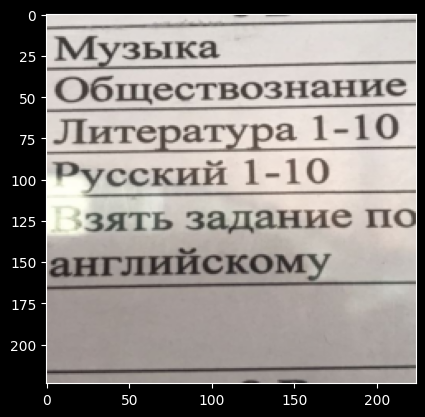

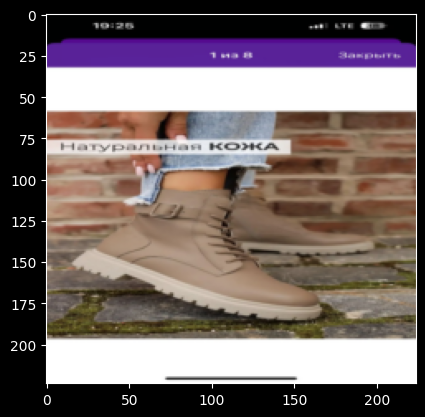

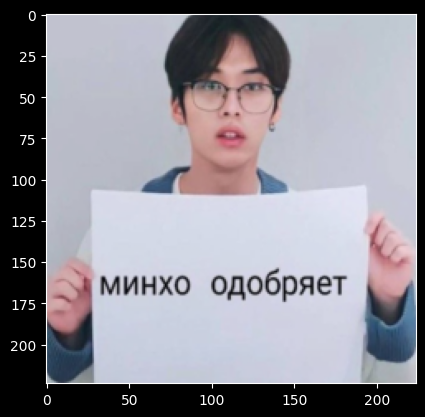

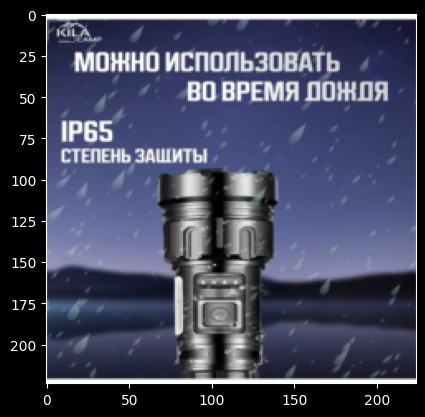

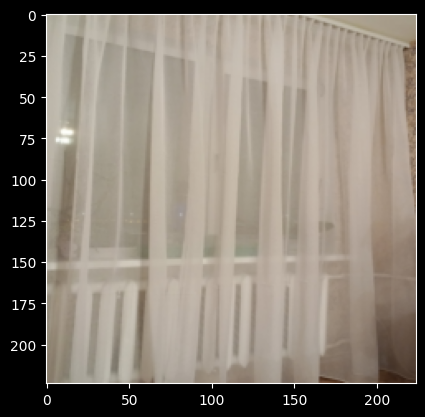

...

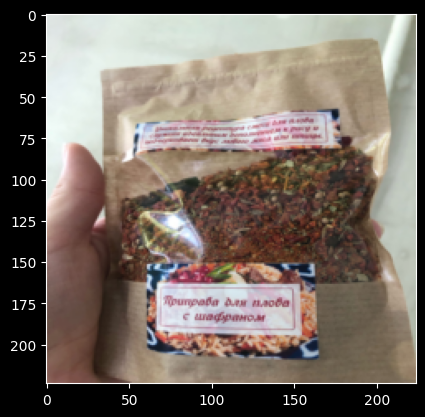

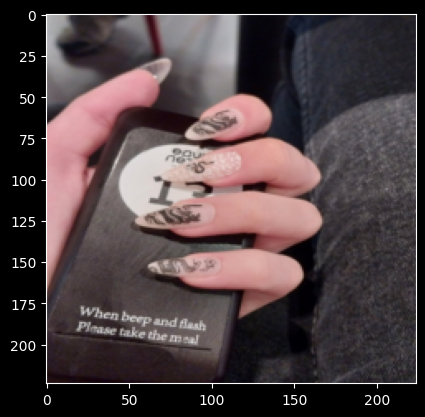

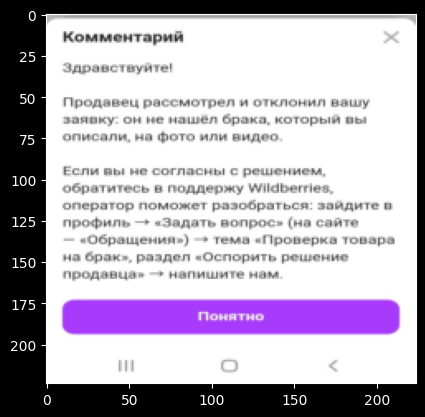

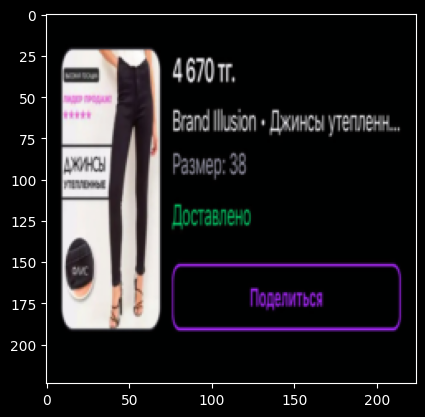

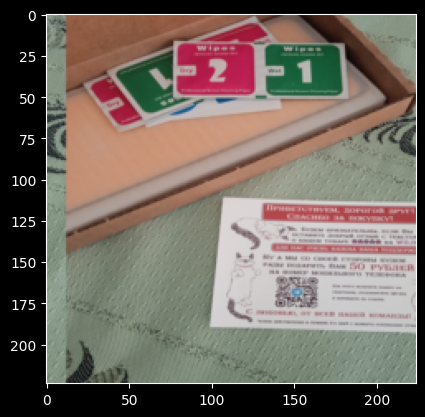

In [91]:
invert_normalize = transforms.Compose(
    [
        transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225],
                                         std=[1/0.229, 1/0.224, 1/0.225]),
    ]
)

for i, data in enumerate(test_dataloader):
    if i in FP[::3]:
        plt.imshow(np.transpose(invert_normalize(data[0][0]).cpu().detach().numpy(), (1, 2, 0)))
    plt.show()

#### FN

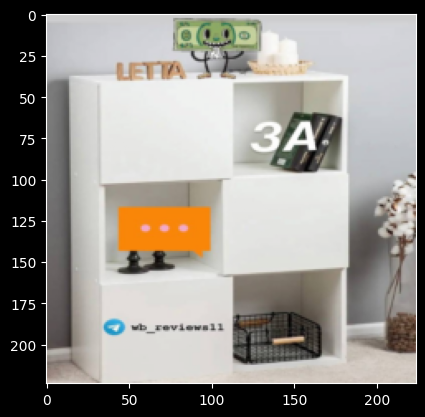

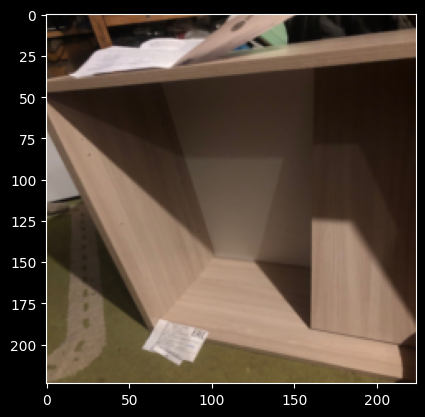

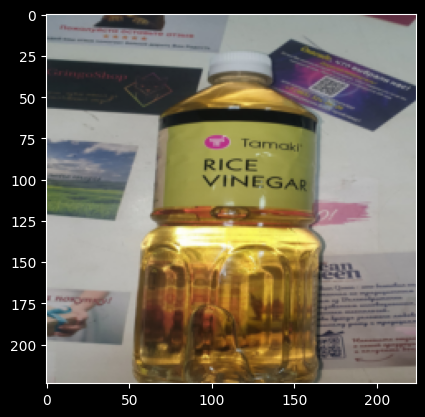

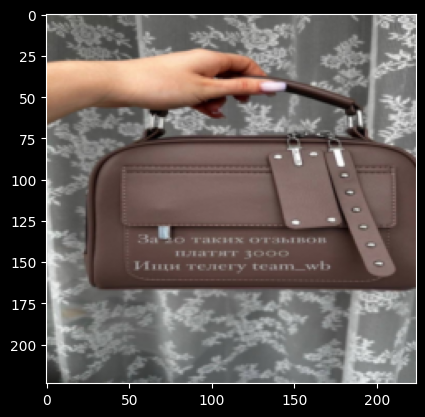

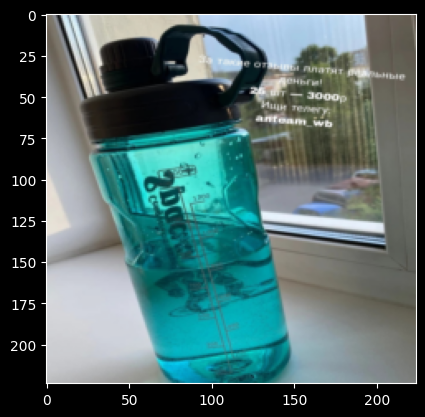

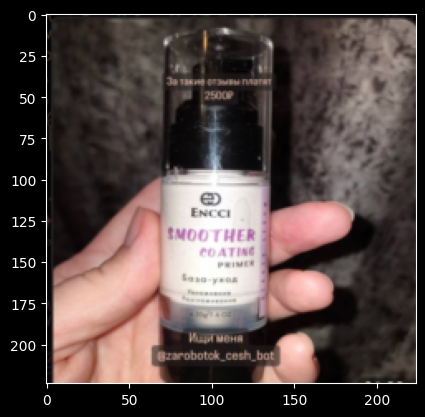

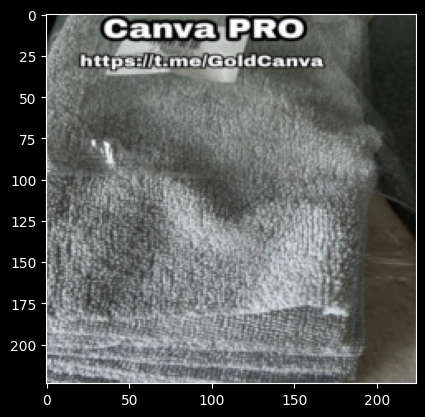

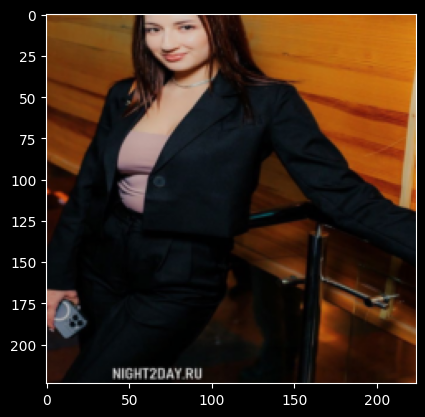

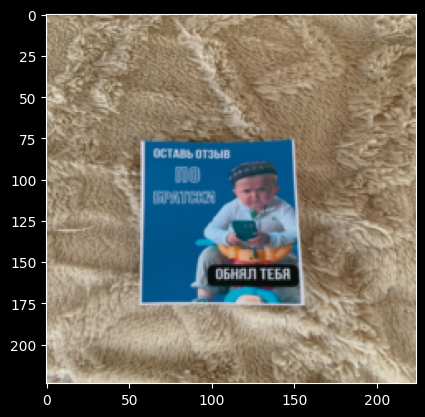

In [92]:
for i, data in enumerate(test_dataloader):
    if i in FN[::3]:
        plt.imshow(np.transpose(invert_normalize(data[0][0]).cpu().detach().numpy(), (1, 2, 0)))
    plt.show()

# Вывод

1. Данные
    - дисбаланс
    - есть некорректно размеченные
    - разные размеры изображений
2. Модель:
    - Испытаны 3 модели, также аугментации
    - лучше всех EffNet(без аугментаций) по метрике f1=93%, на тестовой

# Блок для проверки

Поместите сюда весь необходимый код для тестирования вашей модели на новых данных. Убедитесь что

- Импортируются все библиотеки и классы
- Подгружабтся веса с внешних ресурсов
- Происходит рассчет метрик
...

### test data download & unzip

In [98]:
# пример загрузки данных
!gdown 14K2kTRZak9NsdWt9YTcTKN66Op7cPQov
!unzip test.zip

Downloading...
From: https://drive.google.com/uc?id=14K2kTRZak9NsdWt9YTcTKN66Op7cPQov
To: /content/test.zip
100% 2.70M/2.70M [00:00<00:00, 230MB/s]
Archive:  test.zip
   creating: test/
   creating: test/0/
  inflating: test/0/124453879.jpg    
  inflating: test/0/126503171.jpg    
  inflating: test/0/128829952.jpg    
  inflating: test/0/131170138.jpg    
  inflating: test/0/139609627.jpg    
  inflating: test/0/165136231.jpg    
  inflating: test/0/165145830.jpg    
  inflating: test/0/165153596.jpg    
  inflating: test/0/165619305.jpg    
  inflating: test/0/166722286.jpg    
   creating: test/1/
  inflating: test/1/123935722.jpg    
  inflating: test/1/148907644.jpg    
  inflating: test/1/151411873.jpg    
  inflating: test/1/151523787.jpg    
  inflating: test/1/153593163.jpg    
  inflating: test/1/155254399.jpg    
  inflating: test/1/156468200.jpg    
  inflating: test/1/156628822.jpg    
  inflating: test/1/157869857.jpg    
  inflating: test/1/168744181.jpg    


In [99]:
# путь к тестовым данным
path_to_test = '/content/test'

### weights download

In [100]:
!gdown 10P5sBl49ECPsl5PpHhLJcQRMiAfQGDnU

Downloading...
From: https://drive.google.com/uc?id=10P5sBl49ECPsl5PpHhLJcQRMiAfQGDnU
To: /content/best_epoch=8_valid_f1=0.923_valid_loss=0.144.ckpt
100% 16.3M/16.3M [00:00<00:00, 53.4MB/s]


In [101]:
weights = "/content/best_epoch=8_valid_f1=0.923_valid_loss=0.144.ckpt"

In [102]:
!pip install -q pytorch_lightning==2.0.0 efficientnet_pytorch

In [103]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torch.utils.data.sampler import WeightedRandomSampler
import pytorch_lightning as pl
from torchmetrics import Accuracy, F1Score
from efficientnet_pytorch import EfficientNet

from tqdm.autonotebook import tqdm
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
import warnings

SEED = 21
pl.seed_everything(SEED)
torch.backends.cudnn.deterministic = True
warnings.filterwarnings("ignore")

INFO:lightning_fabric.utilities.seed:Global seed set to 21


In [104]:
transform_test = transforms.Compose(
                [transforms.Resize((224, 224)),
                 transforms.ToTensor(),
                 transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
                 ])

test_set = ImageFolder(path_to_test, transform=transform_test)

test_dataloader = torch.utils.data.DataLoader(
    test_set, batch_size=1, shuffle=False, num_workers=2)

In [105]:
class EffNetClassifier(pl.LightningModule):
  # обязательный метод
  def __init__(self,
               model = "efficientnet-b0",
               in_channels = 3,
               out_classes = 2,
               eta = 3e-4,
               **kwargs):
    super().__init__()
    self.save_hyperparameters()
    self.model = EfficientNet.from_pretrained(model,
                                              num_classes = out_classes,
                                              in_channels = in_channels)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    self.out_classes = out_classes
    class_weights = torch.tensor([0.24, 0.76]).to(device)
    self.criterion = nn.CrossEntropyLoss(weight=class_weights)
    self.metrics = {"accuracy": Accuracy(task="binary", num_classes=out_classes).to(device),
                    "f1_score": F1Score(task="binary", num_classes=out_classes).to(device),
                    "confusion_matrix": confusion_matrix}
    # хотим собирать метрики
    self.preds_stage = {"train":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "valid":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))},
                        "test":{"loss": [], "accuracy":[], "confusion_array": np.zeros((2,2))}}

  # обязательный метод
  def forward(self, x):
    return self.model(x)
  # метод общий для всех
  def shared_step(self,
                  sample,
                  stage):
    x, y = sample
    logits = self.forward(x.to(torch.float32))
    preds = torch.argmax(logits, 1)
    loss = self.criterion(logits, y.to(torch.int64))
    # собираем в атрибут
    self.preds_stage[stage]['loss'].append(loss.detach().cpu())
    self.preds_stage[stage]['accuracy'].append(self.metrics["accuracy"](preds, y).detach().cpu())
    self.preds_stage[stage]['confusion_array'] += (self.metrics["confusion_matrix"](y.cpu().numpy(), preds.cpu().numpy()))
    return loss

  # метод общий для всех
  def shared_epoch_end(self,
                       stage):
    # считаем по стадиям
    loss = self.preds_stage[stage]['loss']
    loss = torch.stack(loss)
    loss = np.mean([x.item() for x in loss])

    acc = self.preds_stage[stage]['accuracy']
    acc = torch.stack(acc)
    acc = np.mean([x.item() for x in acc])

    TN, FP, FN, TP = self.preds_stage[stage]['confusion_array'].ravel()
    precision = TP / (TP + FP) if (TP + FP) > 0 else 0
    recall = TP / (TP + FN) if (TP + FN) > 0 else 0
    f1 = 2 * precision * recall / (precision + recall)

    metrics = {
        f"{stage}_loss": loss,
        f"{stage}_acc": acc,
        f"{stage}_f1": f1
    }

    self.log_dict(metrics, prog_bar=True)
    # чистим
    self.preds_stage[stage]['loss'].clear()
    self.preds_stage[stage]['accuracy'].clear()
    self.preds_stage[stage]['confusion_array'] = np.zeros((2,2))


  # обязательный шаг - создаем оптимизатор, BONUS - шедулер
  def configure_optimizers(self):
    optimizer = torch.optim.SGD(
        self.parameters(),
        lr = self.hparams.eta
    )

    scheduler_dict = {
        "scheduler": torch.optim.lr_scheduler.ReduceLROnPlateau(
            optimizer,
            patience=5
        ),
        "interval": "epoch",
        "monitor": "valid_loss"
    }
    return {"optimizer": optimizer, "lr_scheduler": scheduler_dict}
  # шаг обучения
  def training_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "train")
  # шаг подсчета метрик обучения
  def on_training_epoch_end(self):
      return self.shared_epoch_end("train")
  # шаг валидации
  def validation_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "valid")
  # шаг подсчета метрик валидации
  def on_validation_epoch_end(self):
    return self.shared_epoch_end("valid")
  # шаг тестирования
  def test_step(self,
                    batch,
                    batch_idx):
    return self.shared_step(batch, "test")
  # шаг подсчета метрик тестирования
  def on_test_epoch_end(self):
    return self.shared_epoch_end("test")

In [106]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

model = EffNetClassifier.load_from_checkpoint(weights).to(DEVICE)

Loaded pretrained weights for efficientnet-b0


In [109]:
# список предсказаний
predictions = []
# список целевых
targets = []

model.eval()
with torch.no_grad():
    for X, y in tqdm(test_dataloader):
        outputs = torch.argmax(model(X.to(torch.float32).to(DEVICE)), 1)
        predictions.append(outputs.detach())
        targets.append(y.detach())

predictions = (torch.cat(predictions)).cpu().numpy()
targets = (torch.cat(targets)).cpu().numpy()

  0%|          | 0/20 [00:00<?, ?it/s]

In [110]:
classes = test_set.classes
print(classification_report(targets, predictions, target_names=classes))

              precision    recall  f1-score   support

           0       0.91      1.00      0.95        10
           1       1.00      0.90      0.95        10

    accuracy                           0.95        20
   macro avg       0.95      0.95      0.95        20
weighted avg       0.95      0.95      0.95        20



In [111]:
f1_score(targets, predictions)

0.9473684210526316